In [1]:
import geopandas
import folium
import pandas as pd

from aphp import load

# Aggrégation des données patient au niveau LGA



In [34]:
# aggregating patient data to LGA level

patients = load.load_patient_test_results()
postcode_to_lga = pd.read_csv("../data/postcode_to_LGA.csv", dtype="str")

patients_with_lga = patients.merge(postcode_to_lga, how='left', on='postcode')
patients_with_lga.head()

,age,postcode,state,pcr_positive,lga_code
0,32.0,4210,Victoria,NaN,33430
1,27.0,3338,New South Wales,NaN,24650
2,27.0,3338,New South Wales,NaN,27260
3,36.0,4208,Victoria,False,33430
4,37.0,2617,Victoria,NaN,89399


In [35]:
lga = (
    patients_with_lga.groupby('lga_code')
    .apply(lambda s: pd.Series({
        'n_patients': len(s),
        'n_tested': s['pcr_positive'].notnull().sum(),
        'n_positive': s['pcr_positive'].sum(),
        'f_tested': s['pcr_positive'].notnull().sum() / len(s),
        'f_positive': s['pcr_positive'].astype(float).sum() / s['pcr_positive'].notnull().sum()
    }))
    .reset_index()
)
lga.loc[lga['n_patients'] == 0, ['f_tested']] = pd.np.NaN
lga.loc[lga['n_tested'] == 0, ['f_positive']] = pd.np.NaN

<ipython-input-35-e652cdd4c0b3>:8: RuntimeWarning: invalid value encountered in double_scalars
  'f_positive': s['pcr_positive'].astype(float).sum() / s['pcr_positive'].notnull().sum()
<ipython-input-35-e652cdd4c0b3>:12: FutureWarning: The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead
  lga.loc[lga['n_patients'] == 0, ['f_tested']] = pd.np.NaN
<ipython-input-35-e652cdd4c0b3>:13: FutureWarning: The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead
  lga.loc[lga['n_tested'] == 0, ['f_positive']] = pd.np.NaN


In [36]:
lga.head()

,lga_code,n_patients,n_tested,n_positive,f_tested,f_positive
0,10050,59.0,28.0,5,0.474576,0.178571
1,10110,57.0,26.0,8,0.456140,0.307692
2,10150,69.0,24.0,4,0.347826,0.166667
3,10200,55.0,25.0,7,0.454545,0.280000
4,10250,92.0,40.0,9,0.434783,0.225000


In [37]:
len(lga)

542

In [39]:
lga.count()

lga_code      542
n_patients    542
n_tested      542
n_positive    542
f_tested      542
f_positive    513
dtype: int64

<AxesSubplot:>

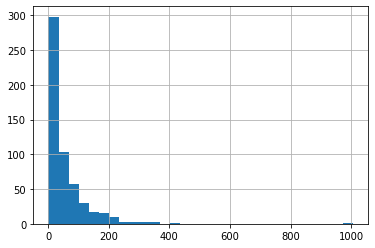

In [41]:
lga['n_patients'].hist(bins=30)

In [42]:
(lga['n_patients'] == 0).sum()

0

<AxesSubplot:>

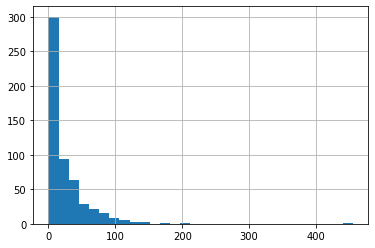

In [43]:
lga['n_tested'].hist(bins=30)

<AxesSubplot:>

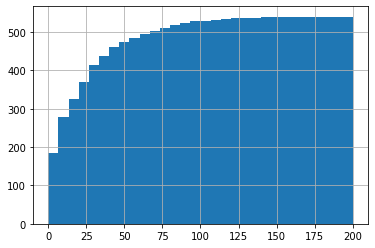

In [52]:
lga['n_tested'].hist(bins=30, cumulative=True, range=[0, 200])

In [53]:
lga.loc[lga['n_tested'] < 5, 'f_positive'] = pd.np.NaN

<ipython-input-53-2b3658fff81e>:1: FutureWarning: The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead
  lga.loc[lga['n_tested'] < 5, 'f_positive'] = pd.np.NaN


<AxesSubplot:>

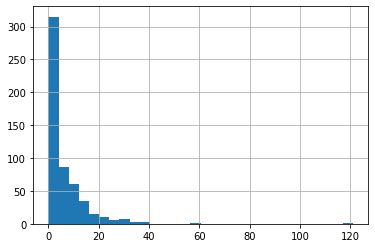

In [54]:
lga['n_positive'].hist(bins=30)

<AxesSubplot:>

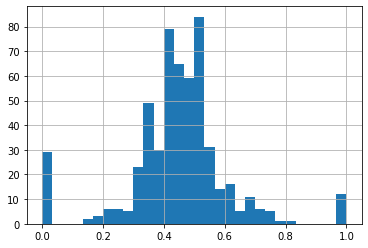

In [55]:
lga['f_tested'].hist(bins=30)

<AxesSubplot:>

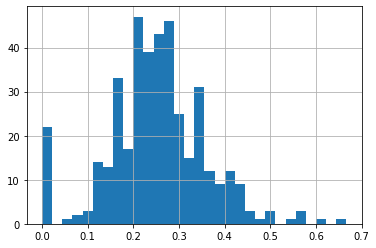

In [56]:
lga['f_positive'].hist(bins=30)

# Regroupement de toutes les infos à l'échelle LGA

In [59]:
map_lga = geopandas.read_file('../data/lga_simplified.shp')
map_lga.head()

,lga_code,geometry
0,10050,"POLYGON ((146.82130 -36.04997, 146.82531 -36.0..."
1,10180,"POLYGON ((151.32425 -30.26923, 151.31688 -30.2..."
2,10250,"MULTIPOLYGON (((153.57094 -28.87390, 153.57172..."
3,10300,"POLYGON ((143.00432 -33.78165, 143.03952 -33.5..."
4,10470,"POLYGON ((149.90753 -33.39968, 149.90683 -33.4..."


In [60]:
map_lga = map_lga.merge(
    pd.read_csv('../data/population_density_per_lga.csv').loc[:, ['lga_code', 'lga_name', 'pop_density_km2']],
    how='left', on='lga_code'
)

map_lga.head()

,lga_code,geometry,lga_name,pop_density_km2
0,10050,"POLYGON ((146.82130 -36.04997, 146.82531 -36.0...",Albury (C),173.1
1,10180,"POLYGON ((151.32425 -30.26923, 151.31688 -30.2...",NaN,NaN
2,10250,"MULTIPOLYGON (((153.57094 -28.87390, 153.57172...",Ballina (A),89.6
3,10300,"POLYGON ((143.00432 -33.78165, 143.03952 -33.5...",Balranald (A),0.1
4,10470,"POLYGON ((149.90753 -33.39968, 149.90683 -33.4...",Bathurst Regional (A),11.2


In [61]:
map_lga = map_lga.merge(lga, how='left', on='lga_code')
map_lga.head()

,lga_code,geometry,lga_name,pop_density_km2,n_patients,n_tested,n_positive,f_tested,f_positive
0,10050,"POLYGON ((146.82130 -36.04997, 146.82531 -36.0...",Albury (C),173.1,59.0,28.0,5,0.474576,0.178571
1,10180,"POLYGON ((151.32425 -30.26923, 151.31688 -30.2...",NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,10250,"MULTIPOLYGON (((153.57094 -28.87390, 153.57172...",Ballina (A),89.6,92.0,40.0,9,0.434783,0.225000
3,10300,"POLYGON ((143.00432 -33.78165, 143.03952 -33.5...",Balranald (A),0.1,7.0,4.0,1,0.571429,NaN
4,10470,"POLYGON ((149.90753 -33.39968, 149.90683 -33.4...",Bathurst Regional (A),11.2,72.0,33.0,9,0.458333,0.272727


In [73]:
import plotly.express as px


px.scatter(
    map_lga.dropna(subset=['pop_density_km2', 'f_tested', 'n_patients']),
    x='pop_density_km2', y='f_tested', size='n_patients',
    title='Fraction des patients testés par LGA en fonction de la densté de population'
)

In [76]:
px.scatter(
    map_lga.dropna(subset=['pop_density_km2', 'f_positive', 'n_tested']),
    x='pop_density_km2', y='f_positive', size='n_tested',
    title='Fraction des tests positifs par LGA en fonction de la densté de population'
)

<AxesSubplot:xlabel='pop_density_km2', ylabel='f_positive'>

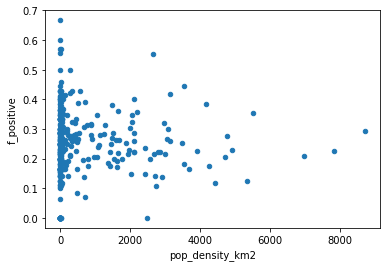

In [69]:
pd.DataFrame(map_lga.loc[:, ['pop_density_km2', 'f_positive']]).plot(kind='scatter', x='pop_density_km2', y='f_positive')

In [83]:
m = folium.Map(
    location=[-28, 130],
    zoom_start=4
)


folium.Choropleth(
    geo_data=map_lga.set_index('lga_code')['geometry'].to_json(),
    name='choropleth',
    data=map_lga,
    columns=['lga_code', 'f_positive'],
    key_on='feature.id',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Fraction de tests PCR positifs'
).add_to(m)

folium.LayerControl().add_to(m)


m

In [85]:
m = folium.Map(
    location=[-28, 130],
    zoom_start=4
)


folium.Choropleth(
    geo_data=map_lga.set_index('lga_code')['geometry'].to_json(),
    name='choropleth',
    data=map_lga,
    columns=['lga_code', 'n_positive'],
    key_on='feature.id',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Nombre de tests PCR positifs'
).add_to(m)

folium.LayerControl().add_to(m)


m